# Digital Signal Proccesing on Audio Tracks

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
# import matplotlib.style as style 
from matplotlib import cm
# style.use('ggplot')
# sns.set_context('notebook')
cmap = cm.coolwarm
# sns.set_palette(cmap)

In [4]:
import struct
from glob import glob
import librosa as lr
import librosa.display

In [5]:
from mpl_toolkits.mplot3d import axes3d
import IPython.display as ipd

%matplotlib inline

In [6]:
audio_path = 'clips_compiled.wav'

In [7]:
audio, sfreq = lr.load(audio_path)
time = np.arange(0, len(audio)) / sfreq
print(f'audio: {audio.shape}\ntime: {time.shape}\nsfreq: {sfreq}')

audio: (793800,)
time: (793800,)
sfreq: 22050


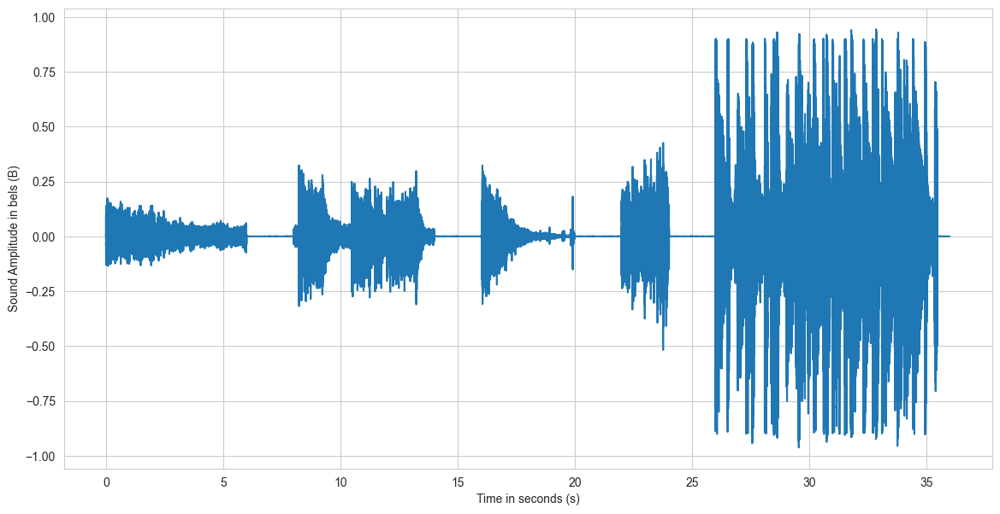

In [8]:
_, ax = plt.subplots(figsize=(14,7))
ax.plot(time, audio)
ax.set(xlabel='Time in seconds (s)', ylabel='Sound Amplitude in bels (B)')
plt.show()

Text(124.47222222222221, 0.5, 'Amplitude (B)')

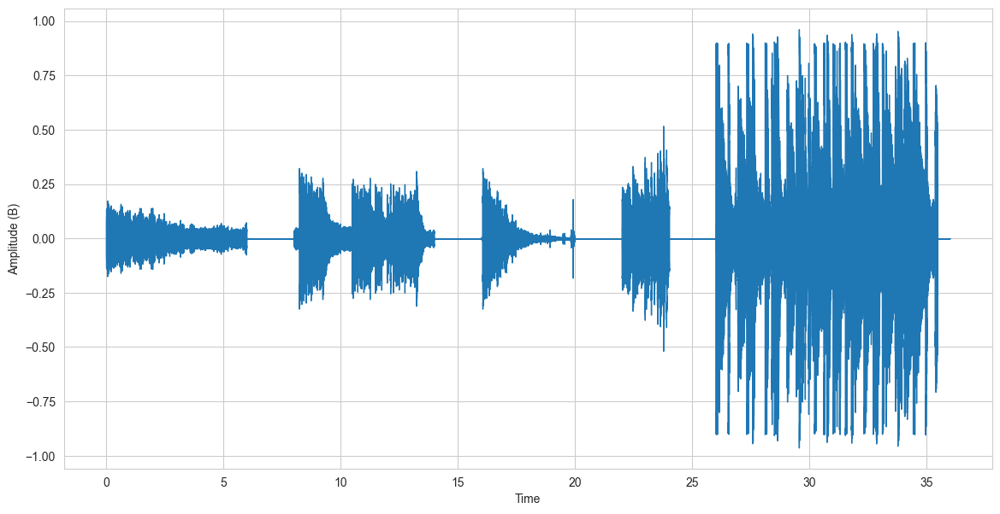

In [9]:
plt.figure(figsize=(14,7))
lr.display.waveshow(audio, sr=sfreq)
plt.ylabel('Amplitude (B)')

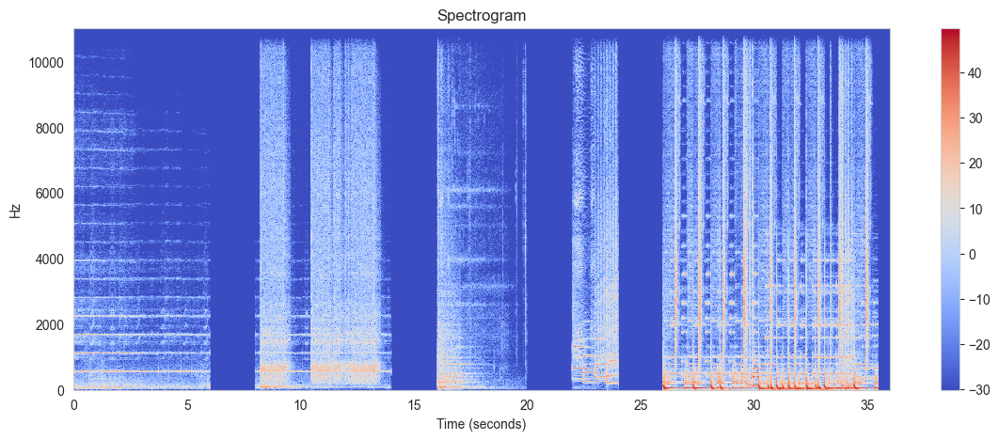

In [10]:
#display Spectrogram
X = librosa.stft(audio)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sfreq, x_axis='s', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
#librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.title('Spectrogram')
plt.colorbar()
plt.show()

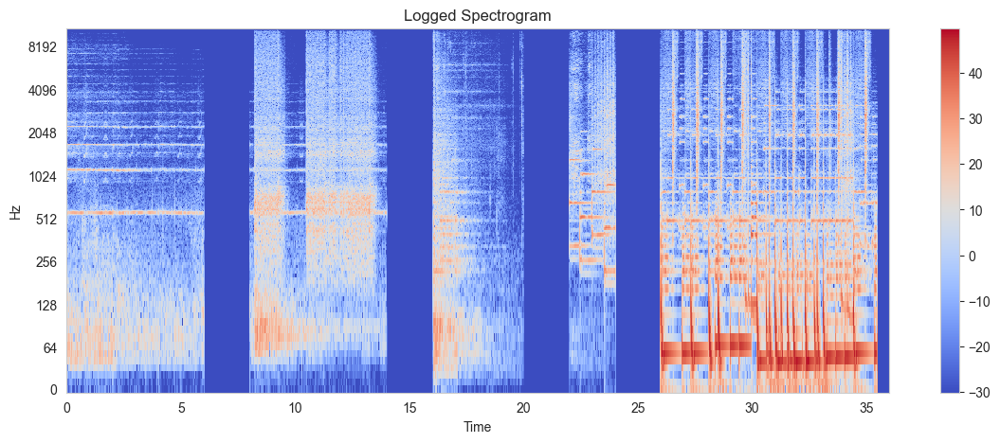

In [11]:
#display Spectrogram
X = librosa.stft(audio)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
# librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='log', cmap=cmap)
plt.title('Logged Spectrogram')
plt.colorbar()
plt.show()

___
___
### Individual clip analysis

In [12]:
clips = [x for x in glob('./audio_files/*.wav')]

In [13]:
amp, sr = lr.load(clips[-1])

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


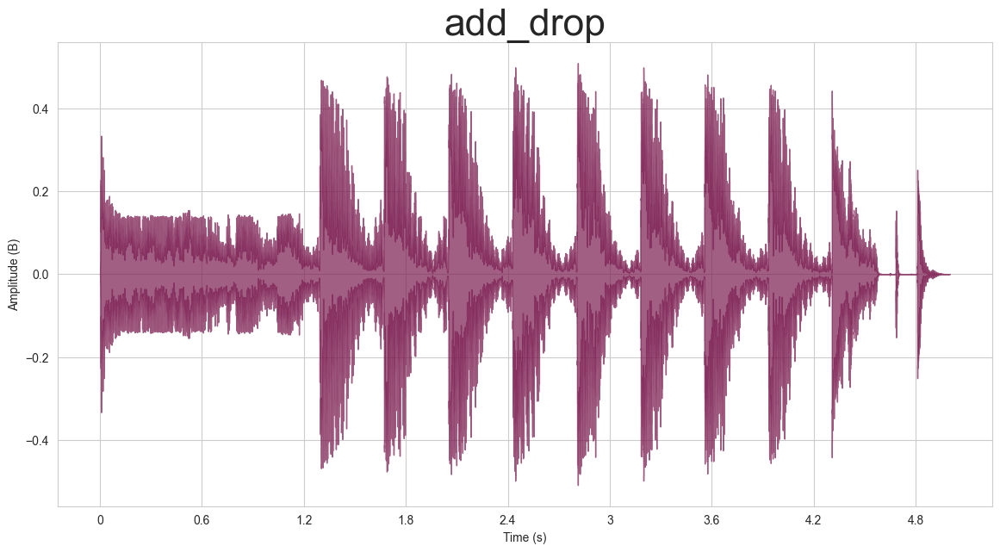

In [14]:
plt.figure(figsize=(14,7))
lr.display.waveshow(amp, sr=sr, alpha=0.7, color='#7a1b4f', x_axis='s')
plt.ylabel('Amplitude (B)')
plt.xlabel('Time (s)')
plt.title(clips[-1].split('/')[-1][:-4], fontsize=32)

ipd.Audio(clips[-1])

In [15]:
clips

['./audio_files/loyal_drum.wav',
 './audio_files/steele_pura_drum.wav',
 './audio_files/steele_pura_bells.wav',
 './audio_files/loyal_horn.wav',
 './audio_files/steele_pura_beat.wav',
 './audio_files/add_drop.wav']

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


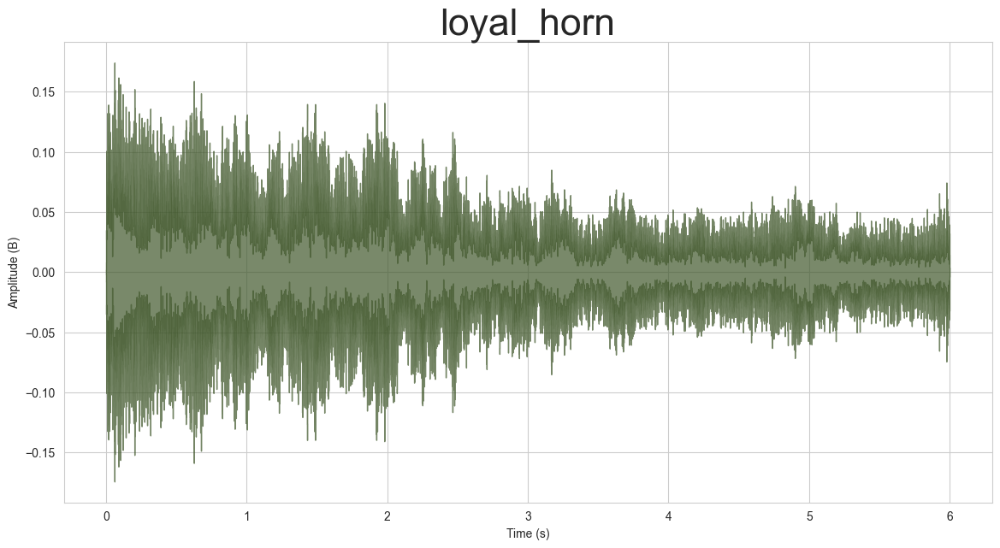

In [16]:
track = clips[3]

amp, sr = lr.load(track)

plt.figure(figsize=(14,7))
lr.display.waveshow(amp, sr=sr, alpha=0.7, color='#40572b', x_axis='s')
plt.ylabel('Amplitude (B)')
plt.xlabel('Time (s)')
plt.title(track.split('/')[-1][:-4], fontsize=32)

ipd.Audio(track)

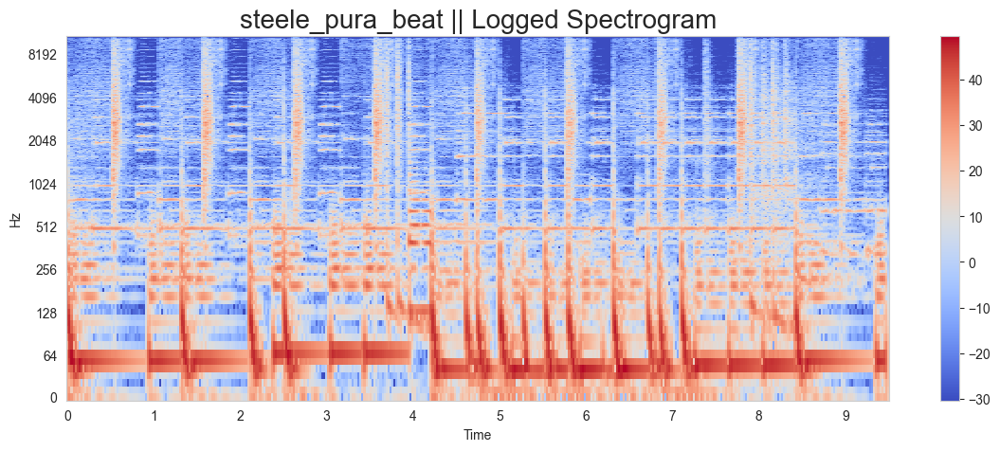

In [17]:
track = clips[-2]

amp, sr = lr.load(track)

#display Spectrogram
X = librosa.stft(amp)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
# librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log', cmap=cmap)
plt.title(track.split('/')[-1][:-4] + ' || Logged Spectrogram', fontsize=20)
plt.colorbar()
plt.show()

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


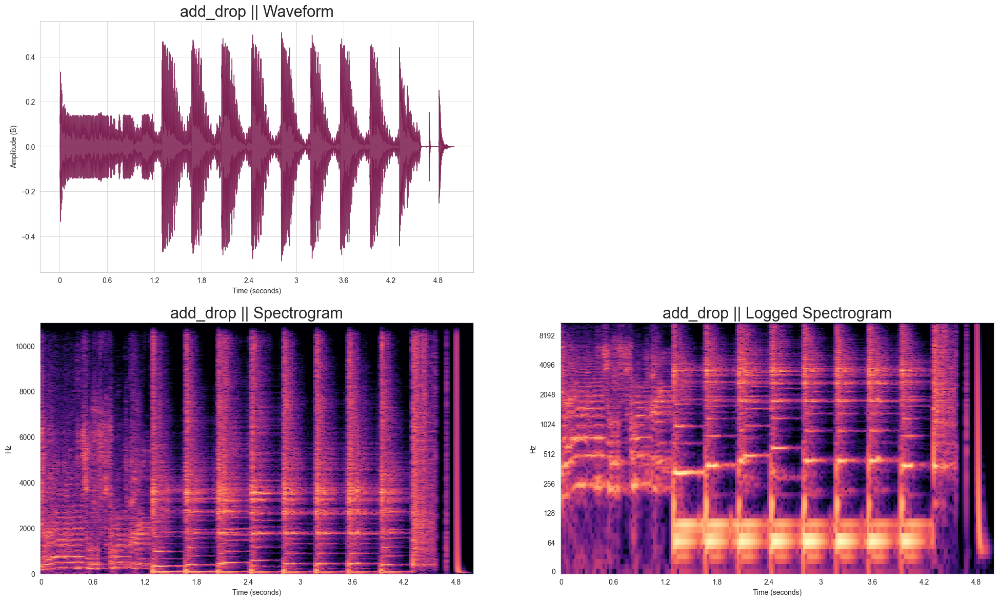

In [18]:
track = clips[-1]

amp, sr = lr.load(track)

_, ax = plt.subplots(nrows=2, ncols=2, figsize=(24,14))
lr.display.waveshow(amp, sr=sr, alpha=0.85, color='#7a1b4f', x_axis='s', ax=ax[0,0])
ax[0,0].set_ylabel('Amplitude (B)')
# ax1.set_xlabel('Time (s)')
ax[0,0].set_title(track.split('/')[-1][:-4] + ' || Waveform', fontsize=22)
ax[0,0].grid(linestyle='-', linewidth='0.5', color='#cccccc')


X = librosa.stft(amp)  # , n_fft=)
Xdb = librosa.amplitude_to_db(abs(X))

librosa.display.specshow(Xdb, sr=sr, x_axis='s', y_axis='hz', cmap='magma', ax=ax[1,0]) 
#If to pring log of frequencies  
ax[1,0].set_title(track.split('/')[-1][:-4] + ' || Spectrogram', fontsize=22)

# plt.colorbar()
ax[1,0].grid(linestyle='-', linewidth='0.5', color='#cccccc')

librosa.display.specshow(Xdb, sr=sr, x_axis='s', y_axis='log', cmap='magma', ax=ax[1,1])
ax[1,1].set_title(track.split('/')[-1][:-4] + ' || Logged Spectrogram', fontsize=22)

ax[0,1].set_visible(False)
ipd.Audio(track)

In [19]:
amp, sr = lr.load(clips[4])

time = np.arange(0, len(track)) / sfreq
t_frames = lr.time_to_frames(time, sr=sr, hop_length=512, n_fft=2048)
t_frames = t_frames.reshape((-1, 1))

D = librosa.stft(amp)  # , n_fft=)
S = librosa.amplitude_to_db(abs(D))
# Dimensions of specrogram D - (f, t)
# t: frames_to_samples
# f: fft_frequencies
# np.abs(D[..., f, t]) is the magnitude of frequency bin f at frame t, and
# np.angle(D[..., f, t]) is the phase of frequency bin f at frame t

print(f'time:\t {time.shape}\nsr:\t\t {sr}\namp:\t {amp.shape}\n'
      f'amp spectropgram: {D.shape}\ndb spectropgram: {S.shape}\ntemporal frames: {t_frames.shape}')


time:	 (26,)
sr:		 22050
amp:	 (110250,)
amp spectropgram: (1025, 216)
db spectropgram: (1025, 216)
temporal frames: (26, 1)


In [20]:
S = np.swapaxes(np.swapaxes(S[:-1], 0, 1)[:-1], 0, 1)
ts = np.arange(0, S.shape[1])  # .reshape((1,-1))
freq = np.linspace(0, sr*S.shape[0], S.shape[0]).reshape((-1,1))

print(f'ts: {ts.shape}\nfreq: {freq.shape}')
np.broadcast_shapes(ts.shape, freq.shape, S.shape)

ts: (215,)
freq: (1024, 1)


(1024, 215)

In [48]:
import plotly.graph_objects as go

sh_0, sh_1 = S.shape
x, y = np.linspace(0, S.shape[1], S.shape[1]), np.linspace(0, sr*S.shape[0], S.shape[0])
fig = go.Figure(data=[go.Surface(z=S, x=x, y=y)])
fig.update_layout(title='Clip name - ADD drop', autosize=False,
                  scene ={            
                    "xaxis": {"nticks": 11, "title": "time"},
                    "yaxis": {"title": "frequency"},
                    "zaxis": {"nticks": 10},
                    'camera_eye': {"x": 0, "y": -1, "z": 1},
                    "aspectratio": {"x": 0.8, "y": 0.6, "z": 0.4}
                  },
                    # dict(
                    # xaxis_title='time',
                    # yaxis_title='Frequency (Hz)',
                    # zaxis_title='Magnitude (dB'),),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
ipd.Audio(clips[-1])

In [22]:
fig = go.Figure(data=[go.Surface(z=S)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Clip Name', autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90)
)
ipd.Audio(track)
fig.show()

In [23]:
# from plotly.subplots import make_subplots
# 
# fig = make_subplots(rows=1, cols=2,
#                     specs=[[{'is_3d': True}, {'is_3d': True}]],
#                     subplot_titles=['Color corresponds to z', 'Color corresponds to distance to origin'],
#                     )
# 
# fig.add_trace(go.Surface(z=S), 1, 1)
# fig.add_trace(go.Surface(z=S), 1, 2)
# fig.update_layout(title_text="Ring cyclide")
# fig.show()

In [25]:
from matplotlib.colors import LightSource

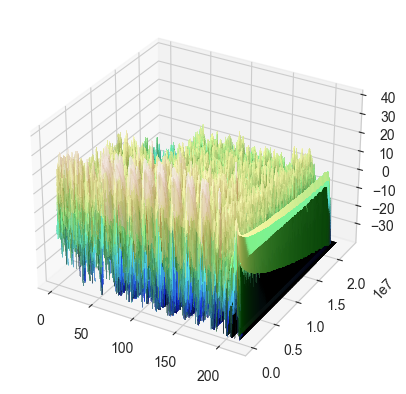

In [55]:
ax = plt.figure().add_subplot(projection='3d')
ls = LightSource(270, 45)
rgb = ls.shade(S, cmap=cm.gist_earth, vert_exag=0.1, blend_mode='overlay')
# Axes3D(0.05)
# ax.plot_surface(np.array(Xdb[0]), amp, np.array([Xdb[1], time[0]]), rstride=4, cstride=4)
# plt.plot3D(S, freq, ts)
X, Y = np.meshgrid(x, y)
ax.plot_surface(X, Y, S, rstride=1, cstride=1, facecolors=rgb, 
                linewidth=0, antialiased=False, shade=False, alpha=0.3)
# ax.contour(ts, freq.reshape((-1)), S, extend3d=True, cmap=cm.coolwarm)
plt.show()